# 分布を見る

![](../images/02/ov5.png)

次は「分布を見る」手法を使ってみましょう。
本書に倣い、ここでは以下の可視化手法を取り上げます：

- [ヒストグラム](hist)
- [密度プロット](dens)
- [箱ひげ図](box)
- [バイオリンプロット](vio)
- [リッジラインプロット](rid)

## 環境構築

必要なライブラリをインポートし、変数を定義します。

In [1]:
# jpholidayを事前にインストール
!pip install jpholiday

In [2]:
# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# typingモジュールからの型ヒント関連のインポート
# 関数やクラスの引数・返り値の型を注釈するためのツール
from typing import Any, Dict, List, Optional, Union

# jpholidayモジュールのインポート
# 日本の祝日を判定する際に使う
import jpholiday

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.figure_factoryのインポート
# 高度なプロットとデータ可視化のためのユーティリティ
# ffという名前で参照可能
import plotly.figure_factory as ff

# plotly.graph_objectsのインポート
# より詳細なグラフ作成機能を利用可能
# goという名前で参照可能
import plotly.graph_objects as go

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

# plotly.subplotsからmake_subplotsのインポート
# 複数のサブプロットを含む複合的な図を作成する際に使用
from plotly.subplots import make_subplots

In [3]:
# 可視化対象が保存されているディレクトリのパス
DIR_IN = Path("../../data/tmp")

# 執筆時間を格納したファイル名
FN_WRITING = "writing_time.csv"

In [4]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

In [5]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

Jupyter Book上に図をきれいに出力するために、以下の関数を定義しておきます。

In [6]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

Plotly Expressライクなインターフェイスで密度プロットを出力するための関数も定義します。
詳細は本書の該当箇所を参照ください。

In [7]:
def create_distplot(
    df: pd.DataFrame,
    x: str,
    color: str = None,
    show_hist: bool = False,
    show_rug: bool = False,
    **kwargs: Any
) -> Figure:
    """
    データフレームから密度プロットとヒストグラムを作成する

    Parameters
    ----------
    df : pd.DataFrame
        プロットするデータを含むデータフレーム
    x : str
        密度プロットの描画対象とするカラム名
    color : str, optional
        データを分割する基準とするカラム名、指定しない場合はx列の全データを用いる
    show_hist : bool, optional
        ヒストグラムを表示するか否か、デフォルトはFalse
    show_rug : bool, optional
        ラグプロットを表示するか否か、デフォルトはFalse
    **kwargs
        ff.create_distplotに渡すその他のキーワード引数

    Returns
    -------
    Figure
        作成されたプロットのFigureオブジェクト
    """

    if color:
        # colorカラムの値でデータをグループ分け
        grouped = df.groupby(color)

        # 各グループのxカラムのデータをリストに格納、可視化用に逆順に並び替え
        hist_data = [group[x].values for _, group in grouped][::-1]

        # 各グループの名前（colorカラムの値）をラベルとしてリストに格納、可視化用に逆順に並び替え
        labels = [str(name) for name, _ in grouped][::-1]

        # 密度プロットとヒストグラムを作成
        fig = ff.create_distplot(
            hist_data, labels, show_hist=show_hist, show_rug=show_rug, **kwargs
        )
    else:
        # colorが指定されていない場合はx列の全データを用いる
        hist_data = [df[x].values]

        # 密度プロットを作成（ラベルはxを指定）
        fig = ff.create_distplot(
            hist_data,
            group_labels=[x],
            show_hist=show_hist,
            show_rug=show_rug,
            **kwargs
        )

    # x軸のタイトルをxに変更
    fig.update_xaxes(title=x)

    # y軸のタイトルを"確率密度"に変更
    fig.update_yaxes(title="確率密度")

    # 作成されたプロットを返す
    return fig

事前に分析対象ファイルを読み込みます。
また、`date`列を基準に年、月、曜日等の列を追加します。

In [8]:
# 分析対象ファイルを読み込み、日付関連の列を追加
df = pd.read_csv(DIR_IN / FN_WRITING)
df["date"] = pd.to_datetime(df["date"])
df["year"] = pd.to_datetime(df["date"]).dt.year
df["weekday"] = pd.to_datetime(df["date"]).dt.weekday
df["is_holiday"] = df.apply(
    lambda row: jpholiday.is_holiday(row["date"]) or row["weekday"] in [5, 6], axis=1
)

(hist)=
## ヒストグラム

ヒストグラムは、量的変数の分布を把握する際の基本的な手法です。
データを複数の区間（ビン）に分割し、各区間に含まれるデータの数を棒の高さで表現します。

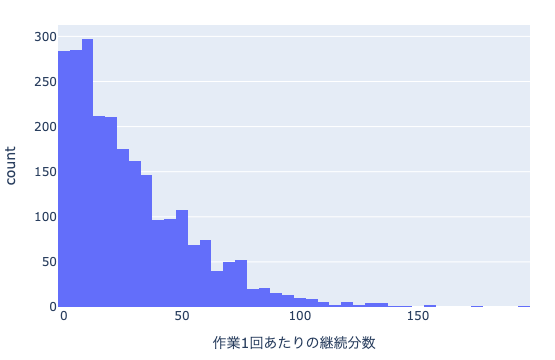

In [9]:
# df_histという名称でプロット用のデータフレームを作成
df_hist = df.copy()
# 作業秒数を60で割って作業分数を算出
df_hist["minutes"] = df_hist["seconds"] / 60

# プロット用に列名を変更
df_hist = df_hist.rename(columns={"minutes": "作業1回あたりの継続分数", "year": "年"})

# ヒストグラムを表示
fig = px.histogram(df_hist, x="作業1回あたりの継続分数")
show_fig(fig)

上図は、作業1回の継続分数の分布を表現したヒストグラムです。
あくまでも 作業1回あたりの継続分数であり、 **一日あたりの合計作業分数ではない** ことに注意しましょう。

まず、 **10分** 付近にピークがあることに気が付きます。
これは、私がポモドーロ[^10min]タイマーを10分に設定して作業していることが原因かもしれません。
一般的なポモドーロ・テクニックでは25分を1セットとするようですが、
私は極端に集中力が続かないため10分で運用しています。

[^10min]: 集中と休憩を繰り返すポモドーロ・テクニックと異なり、私は特に休憩の時間を定めていません。厳密にはポモドーロ・テクニックとは呼べない気がしてきました。

次のピークは、 **50分** 、**60分**、そして **70分** 付近にあるようです。
執筆作業は主に休日か深夜に行いましたが、それでも60分を最小単位として生活を営んでいることが要因の一つと考えられます。例えば：

- 子どもを7:00に起こす
- 子どもの昼寝は15:00まで
- 子どもは21:00までに寝かしつける

のように動いているため、60分単位の作業時間を確保しやすいのかもしれません。

それでは、平日・休日に分けて同様のヒストグラムを作成してみましょう。

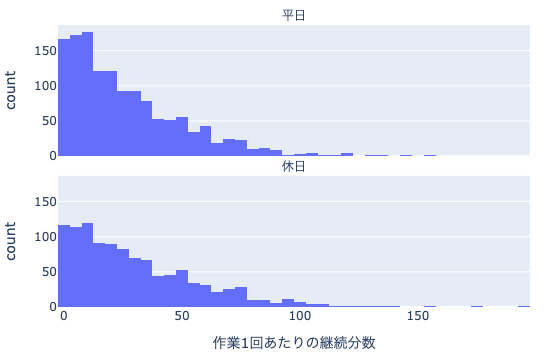

In [10]:
# 可視化用に平日/休日という列を追加し、weekend列を基準に平日か土日を判断
df_hist["作業日"] = df_hist["is_holiday"].apply(lambda x: "休日" if x else "平日")

# 作業日別にヒストグラムをプロット
fig = px.histogram(
    df_hist.sort_values("is_holiday", ignore_index=True),
    x="作業1回あたりの継続分数",
    facet_col="作業日",
    facet_col_wrap=1,
    height=500,
)

# ファセットのタイトルを簡潔にする処理
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 結果を表示
show_fig(fig)

上図は、作業1回の継続時間の分布を表現したヒストグラムを、平日/休日別に表現したものです。
分布形状に大きな差は見られませんが、平日のほうが比較的急峻に見えます。
また、60分にピークがあるのは平日のみです。

次に、年別のヒストグラムを見てみましょう。

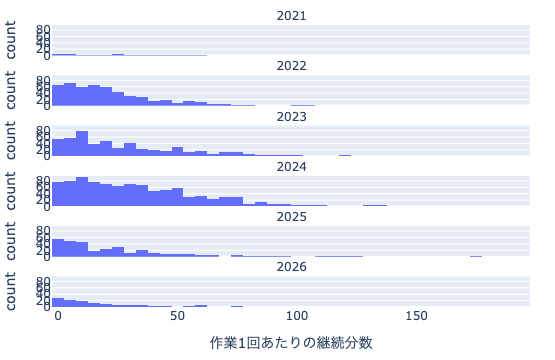

In [11]:
# 年別にヒストグラムを作成
fig = px.histogram(
    df_hist.sort_values("年", ignore_index=True),
    x="作業1回あたりの継続分数",
    facet_col="年",
    facet_col_wrap=1,
    height=600,
)

# ファセットのタイトルを簡潔にする処理
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 結果を表示
show_fig(fig)

上図は、作業1回の継続時間の分布を表現したヒストグラムを、年別に表現したものです。

2023年頃から10分付近のピークが特に目立ちます。
[個人ブログ](https://sizu.me/kakeami/posts/2rcm0ew3ifda)を振り返ると、2023年ごろから10分集中するという施策を始めたようです。
2024年も10分付近にピークがありますが、そこまで目立たくなりました。

(dens)=
## 密度プロット

密度プロットは、カーネル密度推定によって得られた滑らかな曲線で分布を表現する手法です。
ヒストグラムと異なり、ビン幅の影響を受けにくく、より詳細な分布の形状を把握することができます。

ただし、あくまでも
**推定**
結果の可視化でしかない点に注意が必要です。
たとえば、実際にはデータが存在しない領域にも、それらしい「山」を表現してしまうことがあります。

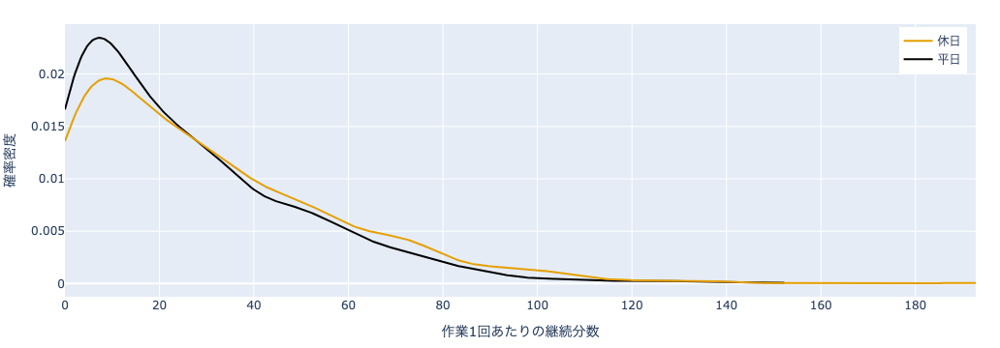

In [12]:
# ヒストグラムで用いたデータフレームを利用
df_dens = df_hist.copy()

# 平日/休日の作業分数の分布を密度プロットで表現
fig = create_distplot(
    df_dens.sort_values("is_holiday", ignore_index=True),
    x="作業1回あたりの継続分数",
    color="作業日",
    colors=OKABE_ITO,
)
# 凡例を図中に表示して描画範囲を有効活用
fig.update_layout(
    hovermode="x unified", legend=dict(yanchor="top", y=0.99, xanchor="right", x=0.99)
)
# 結果を表示
show_fig(fig)

上図は、作業1回あたりの継続時間を、平日と休日で分けて表現した密度プロットです。

ヒストグラムで確認できたような、細かいピークの情報が見られなくなりました。
強いて言えば、平日の方が短時間の作業の割合が多いように見えます。

年別の作業継続時間の分布も可視化してみましょう。

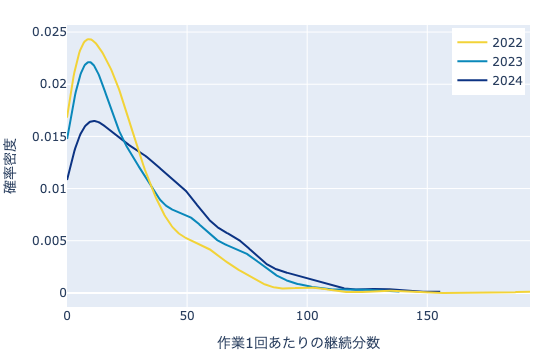

In [18]:
# 年別の作業分数を密度プロットで表現
fig = create_distplot(
    df_dens[(df_dens["年"] >= 2022) & (df_dens["年"] <= 2024)],
    x="作業1回あたりの継続分数",
    color="年",
    colors=px.colors.diverging.Portland,
)
# 凡例を図中に表示して描画範囲を有効活用
fig.update_layout(
    hovermode="x unified", legend=dict(yanchor="top", y=0.99, xanchor="right", x=0.99)
)
# 結果を表示
show_fig(fig)

上図は、作業1回の継続分数の分布を年別に表現した密度プロットです。
対象期間は、とくに草稿執筆作業が本格化した2022年から2024年に絞っています。

ヒストグラムと異なり、密度プロットでは複数の分布を重畳表示することができます。
`2023`年はとくに短時間の作業が多いように見えます。
後述しますが、この期間は大学院との両立に悩んでいました。
一方で`2024`年は長時間の作業が増え始めています。

(box)=
## 箱ひげ図

箱ひげ図は、複数の分布の特徴を要約的に表現する手法です。
文字通り箱とひげを用いて、分布の中心や広がりを視覚化します。
複数の分布を比較する際、最初に候補となるでしょう。

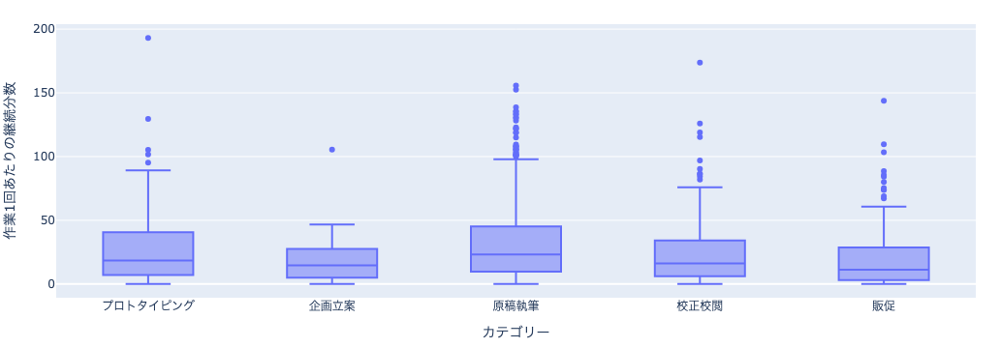

In [19]:
# df_histと同じデータフレームを利用
df_box = df_hist.copy()

# 可視化用に列名を変更
df_box = df_box.rename(columns={"category": "カテゴリー"})

# カテゴリーごとの作業時間を表す箱ひげ図を作成
fig = px.box(df_box, x="カテゴリー", y="作業1回あたりの継続分数")

# 描画した箱ひげ図を表示する
show_fig(fig)

上図は、カテゴリーごとの作業継続時間の分布を表現した箱ひげ図です。

他と比較して、 **企画立案** に関しては1回あたりの作業時間が短いものが多いようです。
企画立案フェーズでは、最終的に本書の目次案を作成することを目的に、次の作業に取り組みました：

- 執筆用のGitHub環境構築
- 参考文献の調査と精読

比較的、細切れに進めやすい作業であることに気づきます。

では、章ごとの作業時間の分布も見てみましょう。
上巻と下巻で分けて表示するため、以下のような関数を定義しておきます。

In [20]:
def get_vol_from_task(task: str) -> str | None:
    """タスク文字列から巻数を取得する

    Parameters
    ----------
    task : str
        タスク文字列

    Returns
    -------
    str | None
        巻数。"上巻"、"下巻"、またはNone。
    """
    if "上巻" in task:
        # タスクに"上巻"が含まれる場合は"上巻"を返す
        return "上巻"
    elif "下巻" in task:
        # タスクに"下巻"が含まれる場合は"下巻"を返す
        return "下巻"
    else:
        # それ以外の場合はNoneを返す
        return None

では、実際に可視化してみましょう。

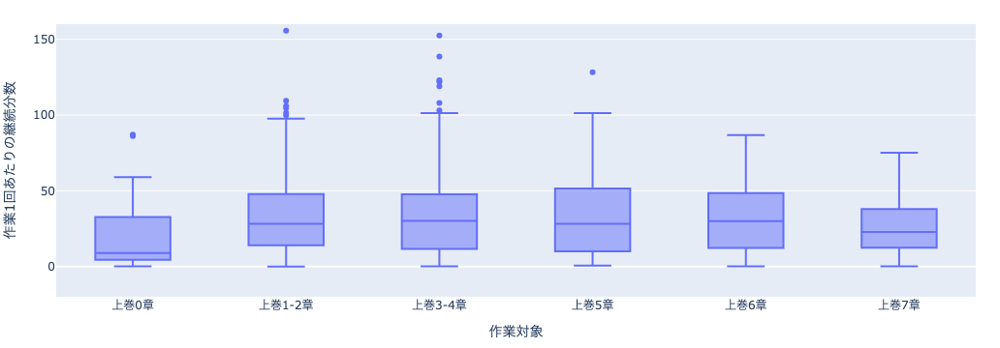

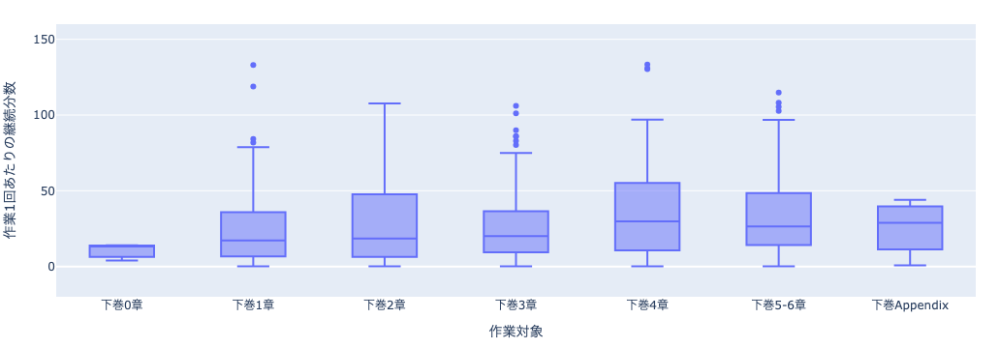

In [21]:
# 上巻あるいは下巻の執筆に関するタスクを抽出
tasks = [t for t in df_box["task"].unique() if ("上巻" in t) or ("下巻" in t)]
# 上記タスクに該当するレコードのみを抽出
df_box2 = df_box[df_box["task"].isin(tasks)].reset_index(drop=True)

# 執筆対象のvol情報を追加し、ソート
df_box2["vol"] = df_box2["task"].map(get_vol_from_task)
df_box2 = df_box2.sort_values("task", ignore_index=True)
# 作業対象を格納する列を追加
df_box2["作業対象"] = df_box2["task"].str.replace("執筆$", "", regex=True)

# volごとに図を分けて表示
for vol, df_vol in df_box2.groupby("vol"):
    # 当該volの執筆に関する作業時間を箱ひげ図で表示
    fig = px.box(df_vol, x="作業対象", y="作業1回あたりの継続分数")
    # Y軸の表示範囲を変更
    fig.update_yaxes(range=(-20, 160))
    # 結果を表示
    show_fig(fig)

上図は、草稿執筆の作業対象別の継続分数の分布を表現した箱ひげ図です。
「上巻1-2章」のように、一部の章が合算されている理由は[データの記録](../01/track)を参照ください。

**上下巻の0章（前付け）** と **下巻Appendix** は、細切れの断続的な作業で完結していることがわかります。
特に下巻0章で顕著ですが、こちらはほぼ上巻0章と同内容であることが原因と考えられます。

**上巻7章** も、比較的短い作業を積み上げて執筆したように見えます。
7章は上巻の終章としてデータ可視化の未来と、下巻との接続としてデータ可視化手法の概説を取り扱っています。
他章と異なり、腰を据えてコーディングする必要がなかったため、ライトに作業を進められたようです。

(vio)=
## バイオリンプロット

バイオリンプロットは、箱ひげ図と密度プロットの長所を組み合わせた手法です。
複数の密度プロットを90度回転し、左右対称[^split]に配置します。
それぞれの分布を詳細に表現しつつ、複数の分布を比較することができます。

[^split]: 本ブログでは割愛しますが、左右 **非対称** な密度プロットを用いるスプリットバイオリンプロットも本書では取り扱います。

ただし、密度プロットと同様、バイオリンプロットも推定結果にすぎません。
その解釈には細心の注意が必要であることも覚えておきましょう。

In [22]:
# 箱ひげ図で用いたデータフレームを流用
df_vio = df_box.copy()
df_vio2 = df_box2.copy()

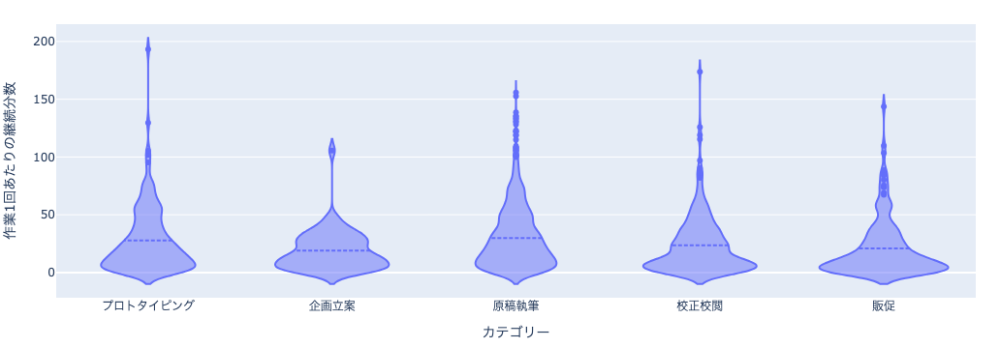

In [23]:
# カテゴリーごとの作業分数の分布をバイオレットで表現
fig = px.violin(df_vio, x="カテゴリー", y="作業1回あたりの継続分数")

# 平均線を表示し、bandwidthを5に設定
fig.update_traces(meanline_visible=True, bandwidth=5)

# バイオリンプロットを重ねて表示し、バイオリン間の間隔を0に設定
fig.update_layout(violinmode="overlay", violingap=0)

# 作成したバイオリンプロットを表示
show_fig(fig)

上図は、カテゴリーごとの作業継続分数の分布を表現したバイオリンプロットです。

**プロトタイピング** と **原稿執筆** の分布が非常に似ているように見えます。
注意深く眺めてみると、前者は60分付近に明確にピークが見られるのに対して、後者はそのようなピークは見られません。
また、 **企画立案** に関して平均線の上下に二つのピークがあるように見えます。

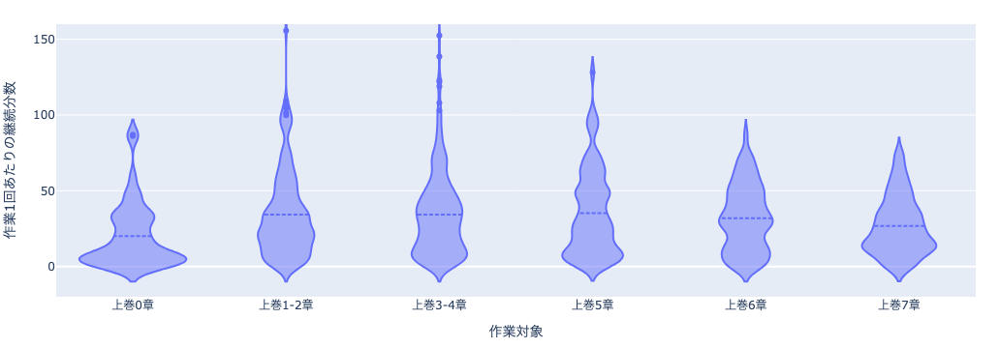

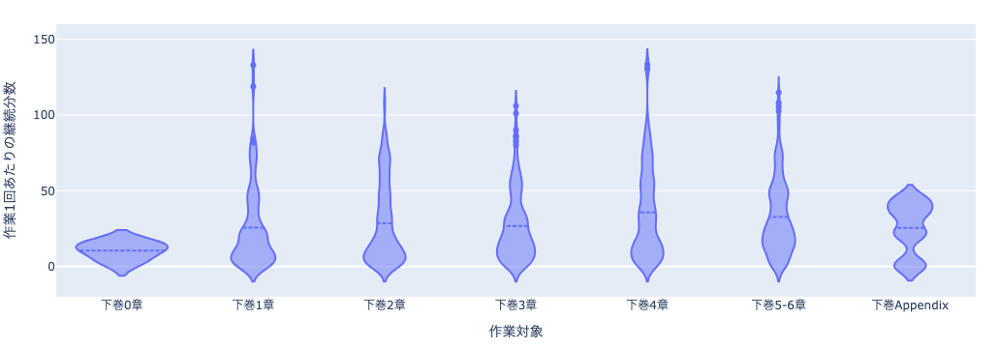

In [24]:
# volごとにバイオリンプロットを作成
for vol, df_vol in df_vio2.groupby("vol"):
    # タスクごとの作業分数の分布を可視化
    fig = px.violin(df_vol, x="作業対象", y="作業1回あたりの継続分数")
    # Y軸の表示範囲を変更
    fig.update_yaxes(range=(-20, 160))

    # 平均線を表示し、bandwidthを5に設定
    fig.update_traces(meanline_visible=True, bandwidth=5)

    # バイオリンプロットを重ねて表示し、バイオリン間の間隔を0に設定
    fig.update_layout(violinmode="overlay", violingap=0)

    # 作成したバイオリンプロットを表示
    show_fig(fig)

上図は、原稿執筆タスクの作業分数の分布を表現したバイオリンプロットです。
こちらに関しても、分布に関して細かい情報が得られるようになりました。

特に目につくのが、 **上巻5章** ではないでしょうか。
上巻5章では、Python・Pandas・Plotlyの基礎を、実装例とともに解説しています。
本書全体を通して、以下の観点で最も特殊な章です：

- **節・項の数が多い** ：データ型、データ構造、そして文法を列挙する構成のため、多くの項・節を立てる必要がありました。
- **節・項間の関連性が薄い** ：他章と比較し、前後の節・項との関連性が弱いという特徴がありました。例えばPythonの基本データ構造としてブール値、整数、浮動小数点、そして文字列を扱いますが、ストーリー上特に順序に拘る必要はありません。

つまり、大量にある細切れの解説項目を、気が向いた順序で執筆できる[^check]ということです。
他章には多かれ少なかれストーリーがありますので、このような形での執筆は馴染みません。
基本的には、順序どおりに話題を繋いでいく必要があるためです。

以上の背景から、上巻5章では多様な粒度の作業が独立に発生し、複数のこぶを持つ分布を形成したのではないでしょうか。

[^check]: もちろん、草稿作成後に、全体を通して前後の流れが不自然でないかチェックしています。

(rid)=
## リッジラインプロット

リッジラインプロットは、分布の経時的な変化等を表現する際に適した手法です。
密度プロットを縦に並べたような見た目をしています。

In [25]:
def get_bimonthly_period(month: int) -> str | None:
    """月の番号から2ヶ月区切りの月情報を取得する

    Parameters
    ----------
    month : int
        月の番号（1から12の整数）

    Returns
    -------
    str | None
        2ヶ月区切りの月情報を表す文字列。
        想定外の月の番号が入力された場合はNoneを返す。

    Examples
    --------
    >>> get_bimonthly_period(1)
    '1-2月'
    >>> get_bimonthly_period(3)
    '3-4月'
    >>> get_bimonthly_period(12)
    '11-12月'
    >>> get_bimonthly_period(0)
    None
    """
    if month < 1 or month > 12:
        # 月の番号が1から12の範囲外の場合はNoneを返す
        return None

    # 月の番号から連番を計算
    period = (month - 1) // 2 + 1

    # 連番から2ヶ月区切りの月情報を生成
    return f"{period * 2 - 1:02}-{period * 2:02}月"

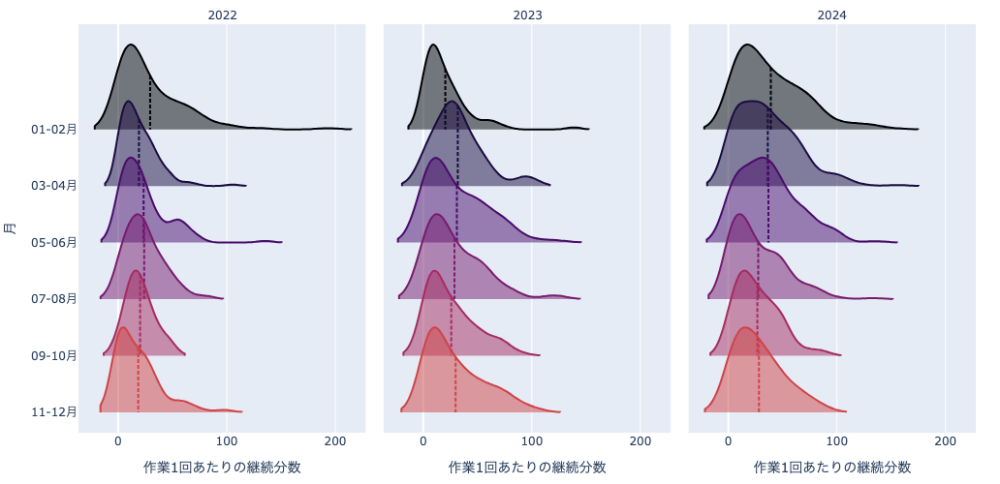

In [27]:
# ヒストグラムと同じデータフレームを利用
df_ridge = df_hist.copy()

# 2022年から2024年に絞り、月に関する情報を追加
df_ridge = df_ridge[(2022 <= df_ridge["年"]) & (df_ridge["年"] <= 2024)].reset_index(
    drop=True
)
df_ridge["月"] = pd.to_datetime(df_ridge["date"]).dt.month.apply(get_bimonthly_period)

# df_ridgeデータフレームを使ってリッジラインプロットを作成
fig = px.violin(
    df_ridge,
    y="月",
    x="作業1回あたりの継続分数",
    orientation="h",
    points=False,
    height=500,
    color="月",
    facet_col="年",
    color_discrete_sequence=px.colors.sequential.Inferno,
)

# side="positive"でバイオリンの片側だけを表示し、width=3でバイオリンの幅を設定
fig.update_traces(side="positive", width=3, meanline_visible=True)

# 混乱を避けるため、凡例を表示しない
fig.update_layout(showlegend=False)

# ファセットのタイトルを簡潔にする処理
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 作成したリッジラインプロットを表示
show_fig(fig)

上図は、年別・月別の作業分数の分布を表現したリッジラインプロットです。
対象期間は2022年から2025年に絞っており、2ヶ月ごとに集計した結果であることに注意してください。

特に2024年の1月から6月に、分布が右に寄っていることがわかります。
この時期は作業の総量が増えただけでなく、一つ一つの作業も重くなっていたようです。